<h1><center>Laboratorio 10: Interpretabilidad 🤖</center></h1>

<center><strong>MDS7202: Laboratorio de Programación Científica para Ciencia de Datos - Primavera 2024</strong></center>

### **Cuerpo Docente:**

- Profesores: Ignacio Meza, Sebastián Tinoco
- Auxiliar: Eduardo Moya
- Ayudantes: Nicolás Ojeda, Melanie Peña, Valentina Rojas

### Equipo: SUPER IMPORTANTE - notebooks sin nombre no serán revisados

- Nombre de alumno 1: Cristobal Ramos 
- Nombre de alumno 2: Catalina Lizana G


### **Link de repositorio de GitHub:** [Repositorio](https://github.com/CatalinaLizanaG/Laboratorio-de-Programaci-n.git)

### Indice

1. [Temas a tratar](#Temas-a-tratar:)
3. [Descripcción del laboratorio](#Descripción-del-laboratorio.)
4. [Desarrollo](#Desarrollo)

## Temas a tratar

- Clasificación usando `XGBoost`.
- Métodos Agnósticos Globales de Interpretabilidad (`Partial Dependence Plot`, `Permutation Feature Importance`)
- Métodos Agnósticos Locales de Interpretabilidad (`Scoped Rules`, `SHAP`)

## Reglas:

- **Grupos de 2 personas**
- Asistencia **obligatoria** a instrucciones del lab (viernes 16.15). Luego, pueden quedarse trabajando en las salas o irse.
- **No se revisarán entregas de personas ausentes**.
- Cualquier duda fuera del horario de clases al foro. Mensajes al equipo docente serán respondidos por este medio.
- Prohibidas las copias.
- Pueden usar cualquer matrial del curso que estimen conveniente.

### Objetivos principales del laboratorio

- Generar un pipeline de clasificación con `XGBoost`.
- Implementar modelos de interpretabilidad para explicar el funcionamiento del modelo de clasificación.

El laboratorio deberá ser desarrollado sin el uso indiscriminado de iteradores nativos de python (aka "for", "while"). La idea es que aprendan a exprimir al máximo las funciones optimizadas que nos entrega `pandas`, las cuales vale mencionar, son bastante más eficientes que los iteradores nativos sobre DataFrames.

# 1. Problemas Clínicos del Dr. Simi

<p align="center">
  <img src="https://gantz.cl/wp-content/uploads/2020/01/79024136_2718114448239059_7240913062570491904_o.jpg" width="350">
</p>

El reconocido **Dr. Simi**, famoso vendedor de medicamentos en latinoamerica, debido a la creciente prevalencia de enfermedades crónicas, como la diabetes, decidió abrir una clínica especializada en el tratamiento de esta enfermedad en nuestro país.

La clínica del Doctor Simi se convirtió en un lugar donde los pacientes con diabetes podrían recibir atención médica integral. El personal médico estaba compuesto por especialistas en endocrinología, nutrición y enfermería, todos capacitados en el manejo de la diabetes.

Sin embargo él se ha dado cuenta que los tiempos han cambiado y gracias a las tecnologías es posible generar mejores predicciones en la diabetes conociendo el historial médico de las personas. Por esto, el doctor se ha colocado una meta de incluir modelos de machine learning dentro de sus clínicas, para ello le ha solicitado crear un modelo capaz de predecir/clasificar diabetes pero le rogó que el desarrollo del modelo tuviera un especial enfoque en la interpretabilidad de lo que hace su modelo.

Para que usted pueda entrenar el modelo, Dr. Simi le ha entregado un dataset de todos los clientes que fueron detectados con diabetes a lo largo de la historia de la clinica. Con ello, adjunta el historial médico de las personas en forma de datos tabulares para que usted pueda realizar fácilmente la clasificación.


In [156]:
import numpy as np
import pandas as pd

df = pd.read_csv('diabetes_data.csv')
df.head(5)

,Age,Sex,HighChol,CholCheck,BMI,Smoker,HeartDiseaseorAttack,PhysActivity,Fruits,Veggies,HvyAlcoholConsump,GenHlth,MentHlth,PhysHlth,DiffWalk,Stroke,HighBP,Diabetes
0,4.0,1.0,0.0,1.0,26.0,0.0,0.0,1.0,0.0,1.0,0.0,3.0,5.0,30.0,0.0,0.0,1.0,0.0
1,12.0,1.0,1.0,1.0,26.0,1.0,0.0,0.0,1.0,0.0,0.0,3.0,0.0,0.0,0.0,1.0,1.0,0.0
2,13.0,1.0,0.0,1.0,26.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,10.0,0.0,0.0,0.0,0.0
3,11.0,1.0,1.0,1.0,28.0,1.0,0.0,1.0,1.0,1.0,0.0,3.0,0.0,3.0,0.0,0.0,1.0,0.0
4,8.0,0.0,0.0,1.0,29.0,1.0,0.0,1.0,1.0,1.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0


In [158]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 70692 entries, 0 to 70691
Data columns (total 18 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Age                   70692 non-null  float64
 1   Sex                   70692 non-null  float64
 2   HighChol              70692 non-null  float64
 3   CholCheck             70692 non-null  float64
 4   BMI                   70692 non-null  float64
 5   Smoker                70692 non-null  float64
 6   HeartDiseaseorAttack  70692 non-null  float64
 7   PhysActivity          70692 non-null  float64
 8   Fruits                70692 non-null  float64
 9   Veggies               70692 non-null  float64
 10  HvyAlcoholConsump     70692 non-null  float64
 11  GenHlth               70692 non-null  float64
 12  MentHlth              70692 non-null  float64
 13  PhysHlth              70692 non-null  float64
 14  DiffWalk              70692 non-null  float64
 15  Stroke             

## 2. Clasificación de pacientes con diabetes (5 puntos)

<p align="center">
  <img src="https://media.tenor.com/QH--g3ZaSbsAAAAC/dr-simi-abrazo.gif" width="400">
</p>

Tareas:
1. En primer lugar, el reconocido doctor le pide entrenar un modelo de `XGBoost` utilizando como target la columna `Diabetes` del dataset `diabetes_data.csv`. Para el entrenamiento, realice los siguientes pasos:
  * Realice una breve exploración de los datos y determine si aplicará transformaciones (MinMaxScaler, StandardScaler, etc.) en alguna/s de las variables. (1 punto)
  * Cree un conjunto de entrenamiento y uno de prueba, con una proporción de 1/3 en el conjunto de prueba. (0.5 puntos)
  * Cree un ColumnTransformer de preprocesamiento donde aplique las transformaciones determinadas anteriormente. Fije el parámetro `verbose_feature_names_out=False` y fije la salida del ColumnTransformer en formato pandas mediante el método `.set_output(transform='pandas')`. (1 punto)
  *  Cree un pipeline donde integre el preprocesamiento y el modelo `XGBoost` y entrene el modelo. Luego utilice `classification_report(..)` para reportar el desempeño del modelo. (1 punto)

Comente sus decisiones y los resultados obtenidos con el modelo.

2. Luego, le pide responder las siguientes preguntas:
  *  ¿Es acaso un buen predictor de diabetes? (0.5 puntos)
  * ¿Qué buscan explicar las métricas utilizadas? (0.5 puntos)
  * ¿Las métricas utilizadas para medir la predictibilidad le permiten asegurar que su modelo haga una buena elección de las features?(0.5 puntos)

In [162]:
#!pip install xgboost

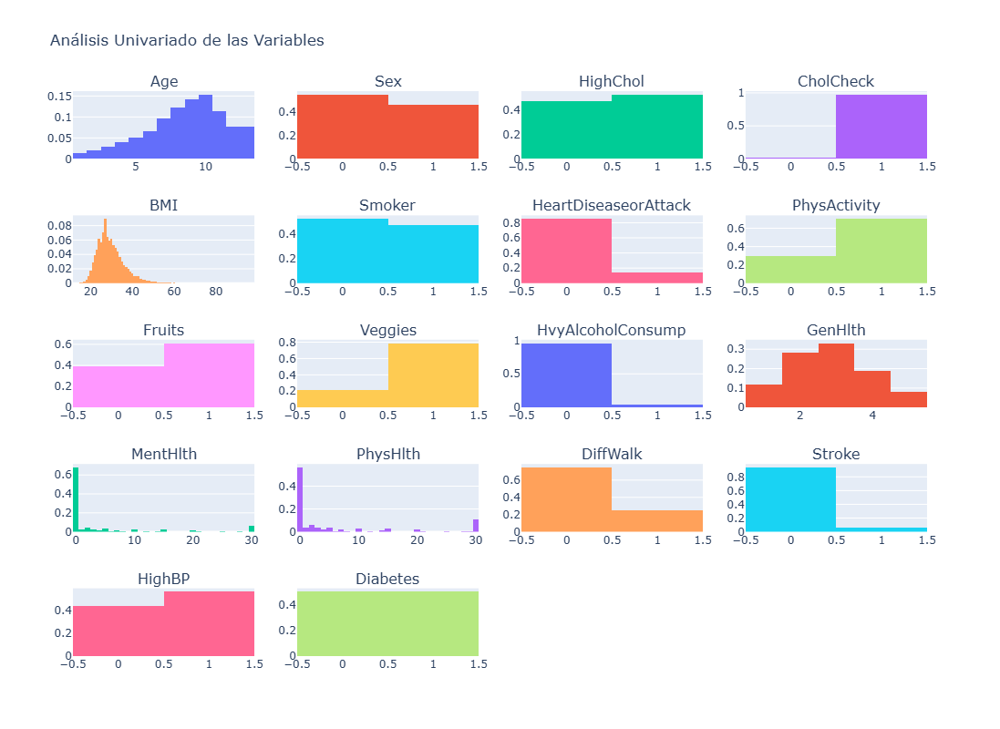

In [164]:
#Parte 1
# 1. Realice una breve exploración de los datos y determine si aplicará transformaciones (MinMaxScaler, StandardScaler, etc.) en alguna/s de las variables. 
import plotly.graph_objects as go
from plotly.subplots import make_subplots

n_cols = 4

fig = make_subplots(
    rows=len(df.columns) // n_cols + 1, cols=n_cols, subplot_titles=df.columns
)

# para todas las variables numéricas, graficar histograma
for idx, col in enumerate(df.columns):
    row_idx = idx // n_cols + 1
    col_idx = idx % n_cols + 1

    hist = go.Histogram(x=df.loc[:, col], name=col, histnorm="probability")
    fig.add_trace(hist, row=row_idx, col=col_idx)

fig.update_layout(
    height=800,
    title_text="Análisis Univariado de las Variables",
    showlegend=False,
)
fig.show()


In [165]:
print(df.describe())

                Age           Sex      HighChol     CholCheck           BMI  \
count  70692.000000  70692.000000  70692.000000  70692.000000  70692.000000   
mean       8.584055      0.456997      0.525703      0.975259     29.856985   
std        2.852153      0.498151      0.499342      0.155336      7.113954   
min        1.000000      0.000000      0.000000      0.000000     12.000000   
25%        7.000000      0.000000      0.000000      1.000000     25.000000   
50%        9.000000      0.000000      1.000000      1.000000     29.000000   
75%       11.000000      1.000000      1.000000      1.000000     33.000000   
max       13.000000      1.000000      1.000000      1.000000     98.000000   

             Smoker  HeartDiseaseorAttack  PhysActivity        Fruits  \
count  70692.000000          70692.000000  70692.000000  70692.000000   
mean       0.475273              0.147810      0.703036      0.611795   
std        0.499392              0.354914      0.456924      0.487345

Las columnas que no tiene valores binarios son Age, BMI, GenHlth, MentHlth y PhysHlth. Averiguamos que representa cada una para evaluar su escalamiento
* Age
* BMI: Índice de Masa Corporal.
* GenHlth: Salud General. Se evalua en escala de 1 a 5, donde 1 en buena y 5 mala 
* MentHlth: Salud mental. Se mide en una escala de 0 a 30 días, donde el paciente indica la cantidad de días, en el último mes, que ha experimentado problemas de salud mental
* PhysHlth: Salud Física. Se mide igual que la salud mental

Dada la forma de los gráficos usaremos StandardScaler para BMI (por su forma gaussiana) y MinMax para GenHlth, MentHlth y PhysHlth

In [167]:
# 2. Cree un conjunto de entrenamiento y uno de prueba, con una proporción de 1/3 en el conjunto de prueba. 
from sklearn.model_selection import train_test_split

features = df.drop(columns =['Diabetes'])
labels = df.loc[:, 'Diabetes']
X_train, X_test, y_train, y_test = train_test_split(features, labels, test_size=1/3, random_state=30)

In [168]:
# 3. Cree un ColumnTransformer de preprocesamiento donde aplique las transformaciones determinadas anteriormente.
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import StandardScaler, MinMaxScaler

c_transformer =  ColumnTransformer(transformers=[("StandScaler", StandardScaler(), ['BMI']),("MMScaler", MinMaxScaler(), ['GenHlth', 'MentHlth','PhysHlth'])],remainder="passthrough", verbose_feature_names_out=False).set_output(transform='pandas')

In [170]:
# 4. Cree un pipeline donde integre el preprocesamiento y el modelo XGBoost y entrene el modelo. 
#Luego utilice classification_report(..) para reportar el desempeño del modelo. 

from sklearn.pipeline import Pipeline
from xgboost import XGBClassifier

model = XGBClassifier()
pipeline = Pipeline([('prepro', c_transformer), ('model', model)])
pipeline.fit(X_train, y_train)

y_pred = pipeline.predict(X_test)

from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

         0.0       0.77      0.71      0.74     11812
         1.0       0.73      0.79      0.76     11752

    accuracy                           0.75     23564
   macro avg       0.75      0.75      0.75     23564
weighted avg       0.75      0.75      0.75     23564



In [171]:
from sklearn.metrics import confusion_matrix
confusion_matrix(y_test, y_pred)

array([[8345, 3467],
       [2463, 9289]], dtype=int64)

Parte 2

 **¿Es acaso un buen predictor de diabetes?**

    Podemos decir que es un predictor regular, no es malo pero es mejorable 
    
 **¿Qué buscan explicar las métricas utilizadas?**
    
    Las métricas buscan explicar la relación entre los verdaderos positivos, verdaderos negativos, falsos positivos y falsos negativos. Esto nos permite identificar el rendimiento de cada clase individualmente y entre ellas.
        
**¿Las métricas utilizadas para medir la predictibilidad le permiten asegurar que su modelo haga una buena elección de las features?**

    No, pues son métricas generales, no hay un desglose de la influencia de las features.

    

## 3. Importancia de las features con XGBoost (5 puntos)

<p align="center">
  <img src="https://media.tenor.com/5JAj5_IiagEAAAAd/dr-simi-dr-simi-dance.gif" width="400">
</p>

Tareas:
1. Para añadir el toque de interpretabilidad que Dr. Simi le pide, se le pide calcular la **importancia de las features** del modelo entrenado utilizando todos los métodos (*weight*, *cover*, *gain*) que posee xgboost usando `plot_importance`. `Hint:` Puede acceder a un paso de un pipeline por su nombre mediante el método `.named_steps[...]` (3 puntos)
2. ¿Los resultados obtenidos con los diferentes métodos son compatibles?, comente sus resultados y a que se debe la igualdad o desigualdad que ve en los resultados. (1 punto)
3. Finalmente, ¿las importancias obtenidas son suficientes para obtener la interpretabilidad de un modelo que utiliza árboles? ¿Qué debilidad presenta este método? (1 punto)

<Figure size 1000x600 with 0 Axes>

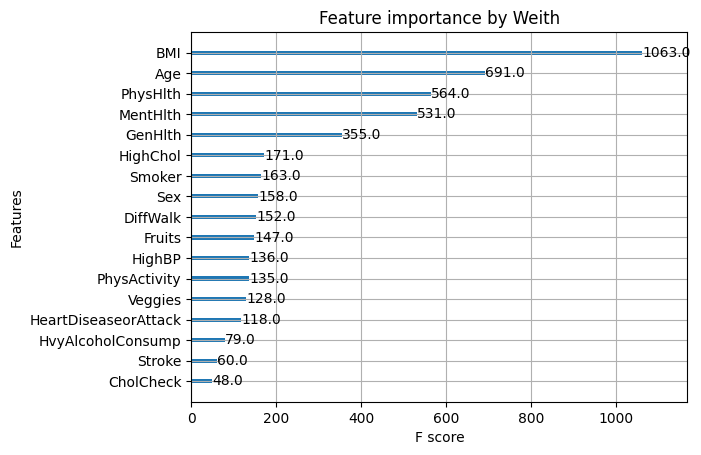

<Figure size 1000x600 with 0 Axes>

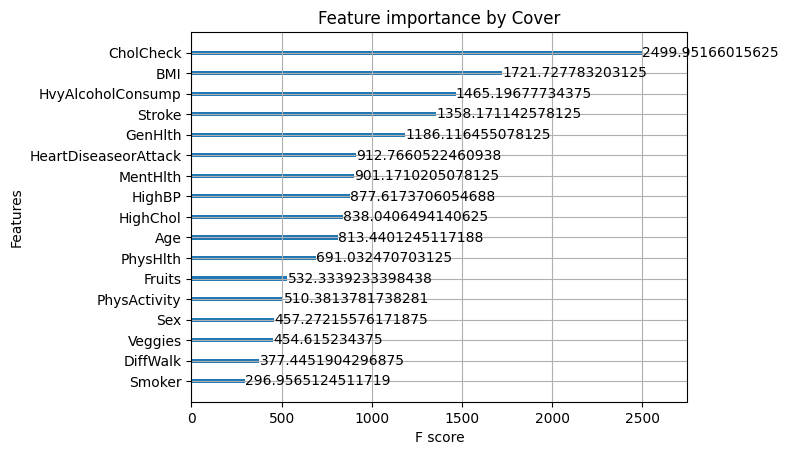

<Figure size 1000x600 with 0 Axes>

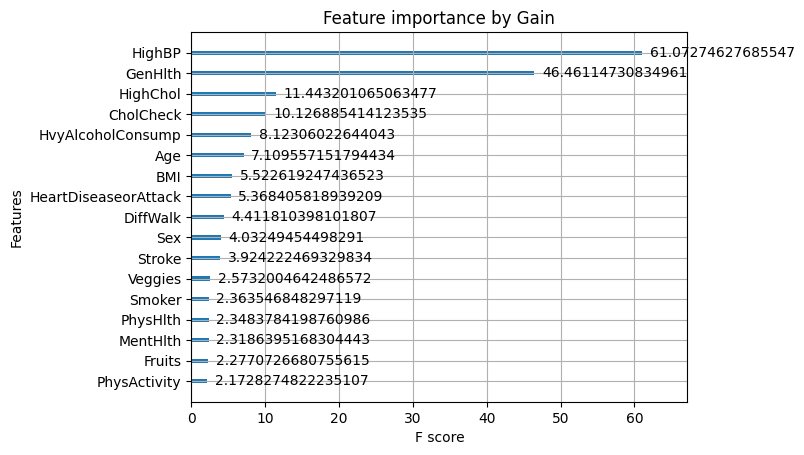

In [180]:
#1. Calcular la importancia de las features del modelo entrenado utilizando todos los métodos (weight, cover, gain) que posee xgboost usando plot_importance. 

from xgboost import plot_importance
import matplotlib.pyplot as plt

xgb_model = pipeline.named_steps['model']

plt.figure(figsize=(10, 6))
plot_importance(xgb_model , importance_type="weight")  
plt.title("Feature importance by Weith")
plt.show()

plt.figure(figsize=(10, 6))
plot_importance(xgb_model , importance_type="cover")  
plt.title("Feature importance by Cover")
plt.show()

plt.figure(figsize=(10, 6))
plot_importance(xgb_model , importance_type="gain")  
plt.title("Feature importance by Gain")
plt.show()


**2. ¿Los resultados obtenidos con los diferentes métodos son compatibles?, comente sus resultados y a que se debe la igualdad o desigualdad que ve en los resultados.**

No son compatibles, el orden de las features y sus valores de F1 score son muy distintas dependiendo de los métodos que se usen, por ejemplo, el atributo 'Age' es la segunda, decima y sexta feature según weight, cover y gain respectivamente. 

La desigualdad de los resultados se debe a las diferentes metodologías utilizadas por cada método, las cuales significan lo siguiente:
- weight: La cantidad de veces que la variables fue usada para dividir los datos a lo largo de todos los árboles.
- cover: La cobertura promedio de la variable en todas las divisiones de cada árbol, donde la cobertura es la proporción de muestras que se ven afectadas por esa división. 
- gain: La ganancia promedio en todas las divisiones de árboles en las que se utilizó la variable. d in.

**3. Finalmente, ¿las importancias obtenidas son suficientes para obtener la interpretabilidad de un modelo que utiliza árboles? ¿Qué debilidad presenta este método?**

Las importancias no son concluyentes, a priori no se sabe qué métrica es mejor para el contexto del problema y por ende, que feature es más importante segun el criterio. Además, una debilidad qeu presenta este método es el error asociado al caso de características con muchos valores posibles, pues estas variables pueden utilizarse muhas más veces para la división de árboles de desición simplemente porque "hay más oportunidades de dividirlas", lo que no implica necesariamente que dicha variable sea más importante. Por estas razones, no son suficientes esas importancias obtenidas para obtener la interpretabilidad del modelo. 

## 4. Métodos Agnósticos Globales (10 puntos)

<p align="center">
  <img src="https://media.tenor.com/JcRHtjVuXN8AAAAC/dr-simi-farmacias-similares.gif" width="400">
</p>

Tareas:
1. Para mitigar los problemas encontrados en la sección anterior, Dr. Simi le pide implementar un **método de permutación** que le permita observar la importancia de las features. `Nota:`Tenga cuidado con el orden de las columnas de este método. `Hint:` Puede obtener los features del clasificador con su respectivo orden mediante el método `.get_booster().feature_names` (2 puntos)
2. Para que su modelo sea consistente, repita el proceso **30 veces** y verifique la desviación estándar de sus resultados (¿Qué señala esta?). (2 puntos)
3. Visualice los resultados de este método en un gráfico. (2 puntos)
4. Además, responda las siguientes preguntas:
  - ¿Cómo mide la importancia de las features su propuesta? (1 punto)
  - ¿Qué features tienen un mayor impacto en la salida del modelo?. Comente las 5 primeras, ¿tienen sentido? (1 punto)
  - ¿Cómo cambian sus conclusiones con respecto a las features importances del punto anterior? (1 punto)
  - Nombre y explique 3 ventajas y 3 desventajas del método implementado. (1 punto)

In [185]:
#1. Implementar un método de permutación que le permita observar la importancia de las features.
#2. Para que su modelo sea consistente, repita el proceso 30 veces y verifique la desviación estándar de sus resultados 
from sklearn.inspection import permutation_importance

result = permutation_importance(xgb_model, X_test[xgb_model.get_booster().feature_names], y_test, n_repeats=30, random_state=30)

In [186]:
result.importances_std

array([0.        , 0.        , 0.00124845, 0.00100079, 0.00171427,
       0.00073222, 0.00121813, 0.00076464, 0.0009839 , 0.00041305,
       0.00089726, 0.00165012, 0.00063091, 0.00039437, 0.00060251,
       0.00026513, 0.00165904])

Los valores de importances_std nos indican las desviaciones de los resultados sobre las $n\_repeats$ iteraciones, para cada variable. Es decir, para cada característica, tras hacer las permutaciones y los cáclulos de errores por cada iteración, ve qué tanto variaron los cálculos de importancia. 

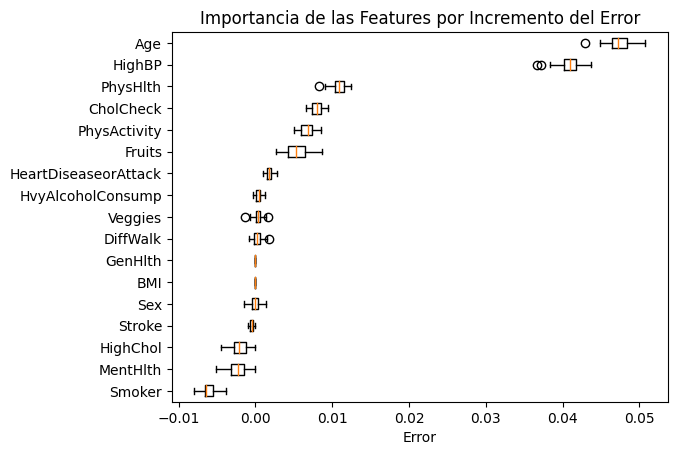

In [188]:
#3. Visualice los resultados de este método en un gráfico. 
perm_sorted_idx = result.importances_mean.argsort()
plt.boxplot(
    result.importances[perm_sorted_idx].T,
    vert=False,
    labels=np.array(xgb_model.get_booster().feature_names)[perm_sorted_idx],
)
plt.title("Importancia de las Features por Incremento del Error")
plt.xlabel('Error')
plt.show()

4. Además, responda las siguientes preguntas:
   
  **- ¿Cómo mide la importancia de las features su propuesta?** \
  Estima la diferecia entre el error del modelo original con el error de modelos entrenados con matrices de características permutadas, en donde cada permutación corresponde a la acción de romper la asociación de una característica $j$ con el resultado verdadero. Así, es posible identificar a las variables con más importancia como las que generan más cambio en el error del modelo al permutar sus valores. 
  
  **- ¿Qué features tienen un mayor impacto en la salida del modelo?. Comente las 5 primeras, ¿tienen sentido?** \
  Las 5 varibles que generan más cambio en el error del modelo, es decir, las que tienen más impacto en la salida del mismo (en orden) son Age, HighBP, PhysHlth, CholCheck, PhysActivity. Esto tiene sentido pues, en orden, dan información de la edad del paciente, si tiene hipertensión, si ha tenido saludo física los últimos $30$ días, información sobre le checkeo de colesterol y si hace actividad física. Todas estas parecen ser importantes a la hora de diagnosticar diabetes.  

  **- ¿Cómo cambian sus conclusiones con respecto a las features importances del punto anterior?** \
  En los resultados anteriores, la mejor posición obtenida por la variable Age fue un segundo lugar con el importance_type: "weith", por lo que hay cambios en los resultados. Sin embargo, vemos que tango Age, como HighBP y CholCheck aparecen en algún top $3$ de imporatancia de los anteriores métodos, por lo podemos decir que hay relación entre los resultados.
  
  **- Nombre y explique 3 ventajas y 3 desventajas del método implementado.** \
  Entre las **ventajas** del método destacamos que: Es facil de interpretar, pues se puede leer a tavés de un gráfico en donde la relación entre aumento de error y mayor importancia es directa; es comparable con más modelos, pues podemos utilizar este método para diferentes modelos de clasificación y obtener resultados de importancia de variables para cada modelo particular; y por último, se puede aplicar el método sin necesidad de re-entrenar el modelo, lo que ahorra recursos en términos de compljidad computacional. \
  En cuanto a **desventajas** del método tenemos que: El análisis está enlazado al error del modelo, por lo que los resultados podrían variar entre un modelo con mucho error versus uno con poco; el método está sujeto a generar sesgos por posibles correlaciones ente las variables, dado que los análisis se basan en la "extracción" de características una a una; y también, añadir una nueva variable que esté correlacionada a otra existente, puede bajar la importancia de la segunda al "repartir" dicha importancia entre las dos características.  

## 5. Métodos Agnósticos Locales (20 puntos)

<p align="center">
  <img src="https://i.makeagif.com/media/10-24-2024/oMCrLI.gif" width="400">
</p>

### 5.1 Calculando Shap Values (4 puntos)

Tareas:
1. Alegre por saber cómo funciona el modelo de predicción a nivel general, Dr. Simi le pide ahora interpretar las predicciones de su modelo a nivel de paciente (es decir, desde un punto de vista **local**). Para esto, el ilustre farmacéutico le pide calcular los *shap values* de su modelo. (2 puntos)
2. ¿Qué representa cada número en su resultado? (1 punto)
3. ¿Es posible atribuir un significado a la positividad/negatividad de cada valor? (1 punto)

In [193]:
#!pip install shap
#import shap

In [207]:
import warnings
warnings.filterwarnings("ignore", message=".*The 'nopython' keyword.*")

In [209]:
# 1. Para esto, el ilustre farmacéutico le pide calcular los *shap values* de su modelo. 
explainer = shap.TreeExplainer(xgb_model)
shap_values = explainer(features)

shap_values

.values =
array([[ 2.08254623e+00,  1.10805440e+00,  1.36761352e-01, ...,
         1.96960904e-02, -3.33627276e-02,  2.90442288e-01],
       [-2.72061586e-01,  1.25234509e+00, -4.61693197e-01, ...,
         2.15331510e-01,  8.53595585e-02,  3.20620209e-01],
       [ 1.28834927e+00,  1.19171715e+00,  1.76650420e-01, ...,
         8.86516422e-02, -2.29843520e-02, -4.74587709e-01],
       ...,
       [-1.17391121e+00, -4.06295568e-01, -2.29296520e-01, ...,
         3.76355708e-01, -3.10358778e-03,  8.27605188e-01],
       [-3.24632615e-01, -3.92873466e-01, -4.22154725e-01, ...,
         3.11755210e-01, -1.40648335e-02,  7.64732182e-01],
       [ 3.76171589e-01, -4.41461414e-01, -3.55088651e-01, ...,
        -2.48514898e-02, -1.69572630e-03,  9.03110743e-01]], dtype=float32)

.base_values =
array([-0.00562747, -0.00562747, -0.00562747, ..., -0.00562747,
       -0.00562747, -0.00562747], dtype=float32)

.data =
array([[ 4.,  1.,  0., ...,  0.,  0.,  1.],
       [12.,  1.,  1., ...,  0.,  1.

In [211]:
shap_values.values[0,:].shape

(17,)

**2. ¿Qué representa cada número en su resultado?** \
Cada número es un valor  de "aporte" de cada una de las variables con las que se entrenó el modelo, respecto a la predicción de la etiqueta de poseer o no diabetes. 

**3. ¿Es posible atribuir un significado a la positividad/negatividad de cada valor?** \
Si, el signo del valor (negativo o positivo) indica si el aporte de la variable para detectar la etiqueta de interés es negativo o positivo respectivamente, es decir, indica si en efecto la variable aporta o "estorba" al momento de detectar el label.

### 5.2 Aporte local (4 puntos)

1. Usando los *shap values* calculados, grafique el **aporte local** de las diferentes variables para las instancias **1**, **9** y **150** (1 punto).

2. Interprete sus resultados y responda:

  - ¿Qué variables afectan de manera positiva/negativa a la probabilidad de poseer diabetes? (1 punto)

  - ¿Existe algún patrón común entre las instancias analizadas? (1 punto)

  - ¿Es posible generalizar estas conclusiones a todo el dataset? (1 punto)

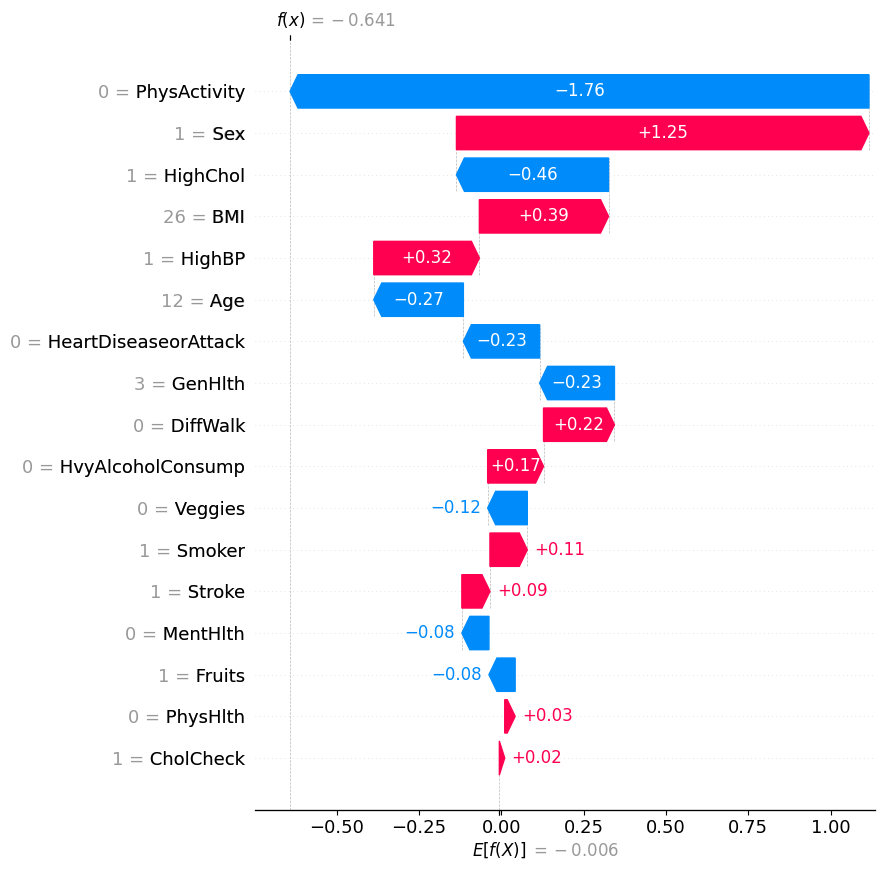

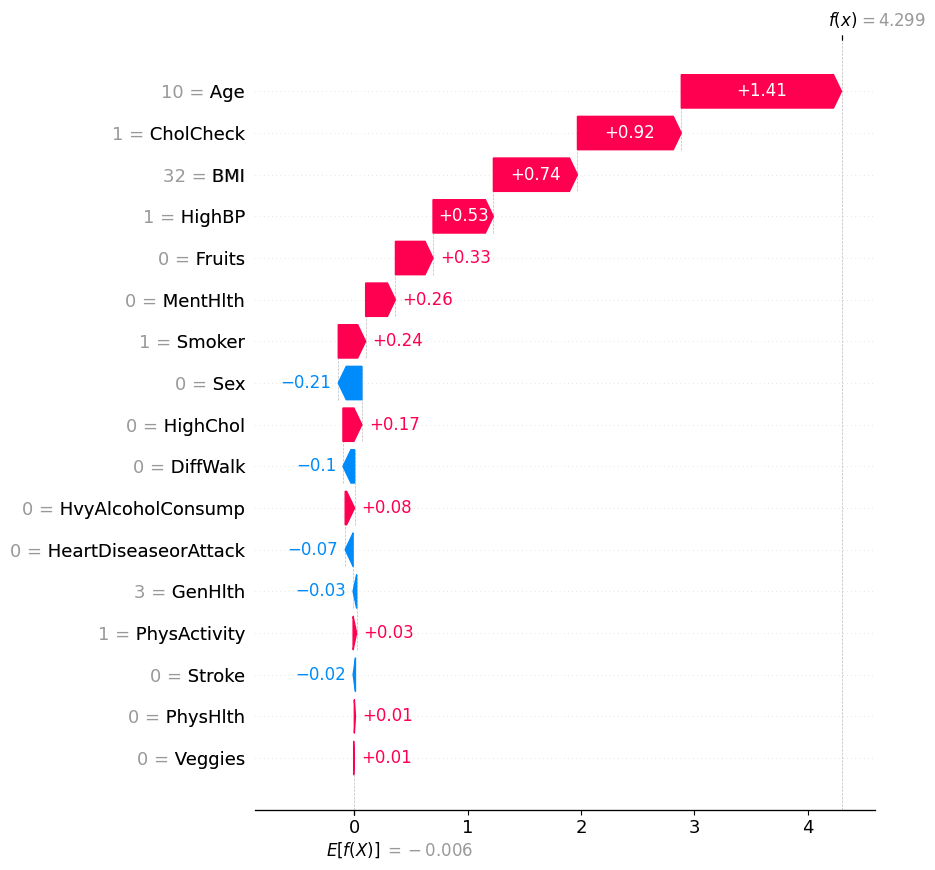

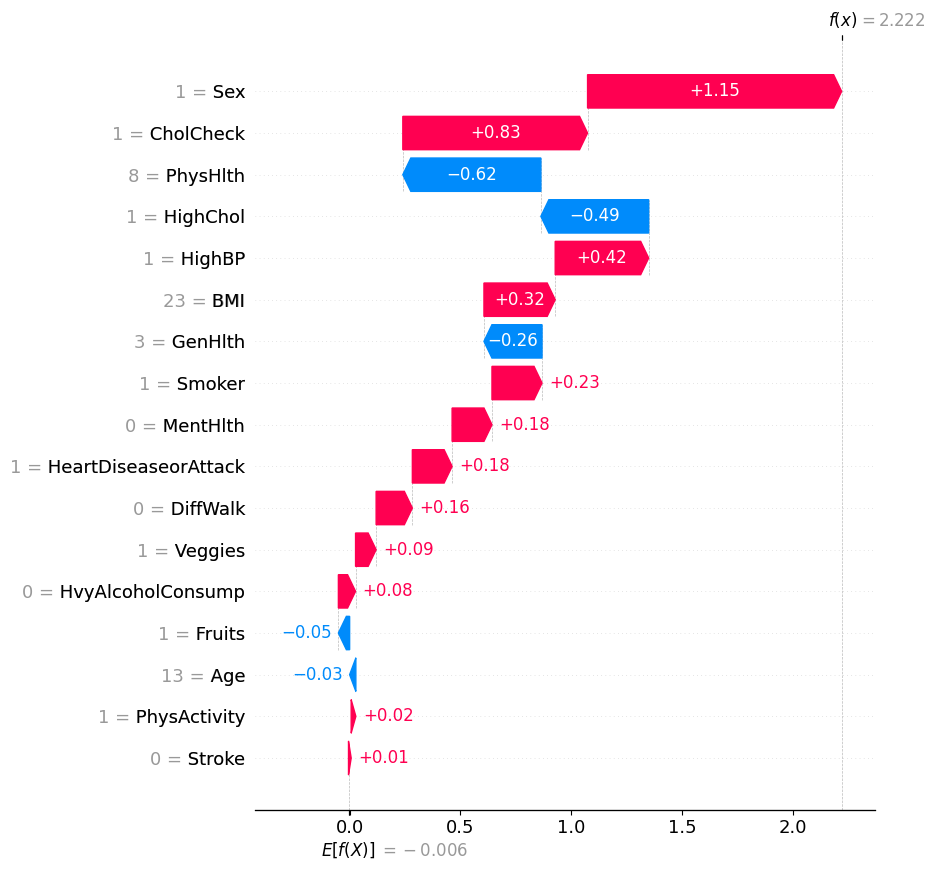

In [215]:
# 1. Usando los *shap values* calculados, grafique el aporte local de las diferentes variables para las instancias 1, 9 y 150

idx = [1,90,150]
for i in idx:
    shap.plots.waterfall(shap_values[i,:], max_display=17)
    #shap.force_plot(explainer.expected_value, shap_values.values[i,:], features.iloc[i,:],link="logit")

2. Interprete sus resultados y responda:

  **¿Qué variables afectan de manera positiva/negativa a la probabilidad de poseer diabetes?** \
  Revisando las tres instancias analizadas vemos que en cada cada una, los signos de los aportes de las vairiables es distinto. Por ejemplo, la variable "sex" aporta de forma positiva (y en gran magnitud) en las instancias $1$ y $3$ de las analizadas, mientras que en la segunda afecta de forma negativa (y en menor magnitud). 

  **¿Existe algún patrón común entre las instancias analizadas?** \
  Por otro lado, vemos que en efecto hay patrones que se repiten en las tres instancias analizadas. En ellas, las variables BMI, HighBP, HvyAlcoholConsump, Smoker, CholCheck afectan de manera positiva a la probabilidad de tener diabetes. Mientras que, nuevamente en las tres instancias, la característica GenHlth afectó de manera negativa en las predicciones. 

  **¿Es posible generalizar estas conclusiones a todo el dataset?** \
  En principio las conclusiones no son generalizables pues el análisis realizado es solo local y no global. Sin embargo, frente la posibilidad de generalizacion de las conlusiones creemos lo siguiente: 
  - Por un lado, tres muestras no es suficiente para generalizar los comportamientos de las variables, por lo que habría que repetir el análisis con más instancias si se quisiese hacer una generalización más robusta. 
  - Por otro lado, las variables que podrían tener mayor probabilidad de generalizar su compartamiento de forma correcta, son aquellas en donde no solo el signo, si no también la magnitud de sus valores son constantes. Por ejemplo, en las tres instancias las variables BMI y HighBP fueron positivas y a la vez tuvieron una magnitud alta en la predicción, mientras que las otras variables que fueron siempre positivas no tuvieron una participación consistente en las tres instancias. Por lo que las primeras dos variables mencionadas son mas propensas a siempre realizar un aporte positivo. 

### 5.3 Aporte global (4 puntos)

Genere ahora una visualización donde se grafique el aporte de cada feature a nivel **global** e interprete sus resultados. ¿Qué diferencias existen con las conclusiones generadas a nivel de instancia?

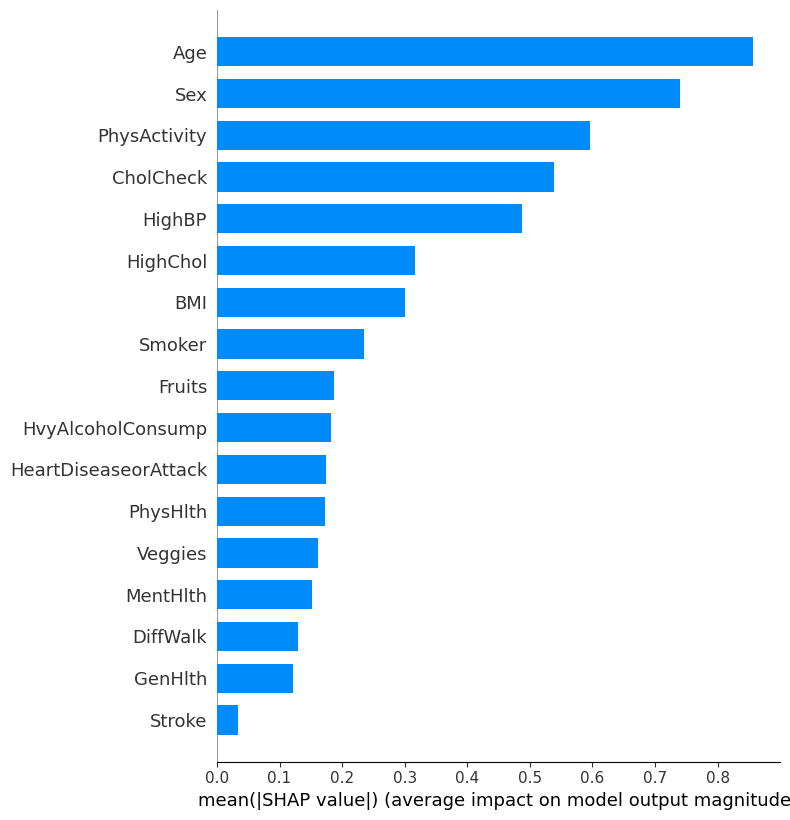

In [220]:
# Inserte código para generar gráficos de aporte global aquí
shap.summary_plot(shap_values, X_train, plot_type='bar')

**¿Qué diferencias existen con las conclusiones generadas a nivel de instancia?** \
Vemos que las primeras tres variables que representan un mayor aporte a nivel global en la predicción (Age, Sex, PhysActivity), no coinciden con las variables que tuvieron siempre un aporte positivo en las instancias revisadas anteriormente.  \
Por otro lado, aparece en cuarto lugar del análisis global la característica CholCheck, que si bien fue siempre positiva en los análisis locales, no era una de las variables que mantuvo su magnitud de participación en todas las instancias. \
El análisis de aporte global si da cuentas de una visión general de las variables con respecto a su aporte en la predicción de la etiqueta. 

### 5.4 Scatter plot (4 puntos)


Grafique ahora un *scatterplot* entre los *shap values* y las primeras 5 features con mayor impacto global (un gráfico por cada feature), coloreando cada punto por la probabilidad de tener diabetes. ¿Qué puede concluir de sus resultados?

In [225]:
#shap values
shap_values_abs = np.mean(np.abs(shap_values.values), axis=0)

#nombres ordenados de mayor a menor
feature_importance_names = X_train.columns[shap_values_abs.argsort()[::-1]]
feature_importance_names

Index(['Age', 'Sex', 'PhysActivity', 'CholCheck', 'HighBP', 'HighChol', 'BMI',
       'Smoker', 'Fruits', 'HvyAlcoholConsump', 'HeartDiseaseorAttack',
       'PhysHlth', 'Veggies', 'MentHlth', 'DiffWalk', 'GenHlth', 'Stroke'],
      dtype='object')

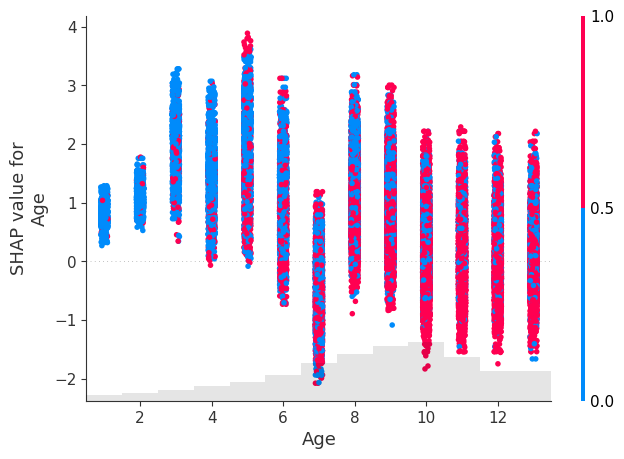

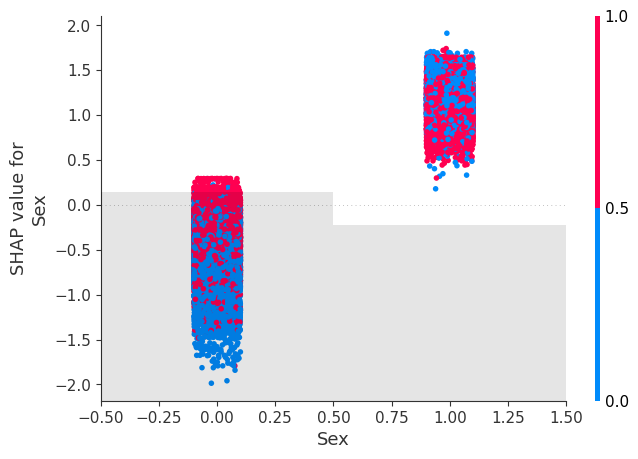

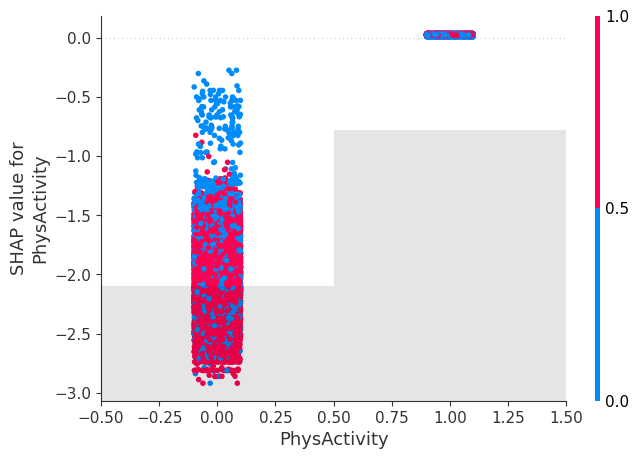

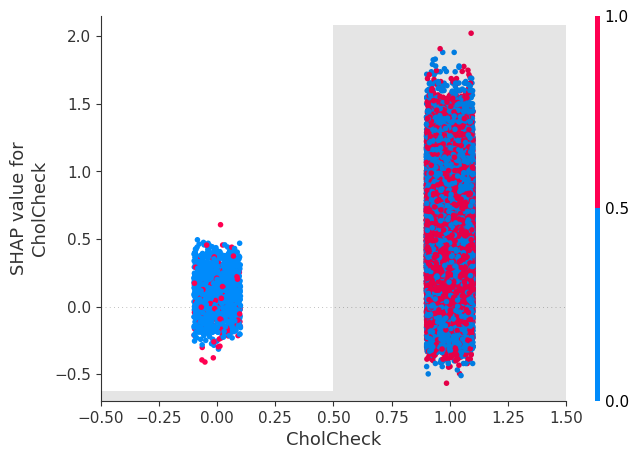

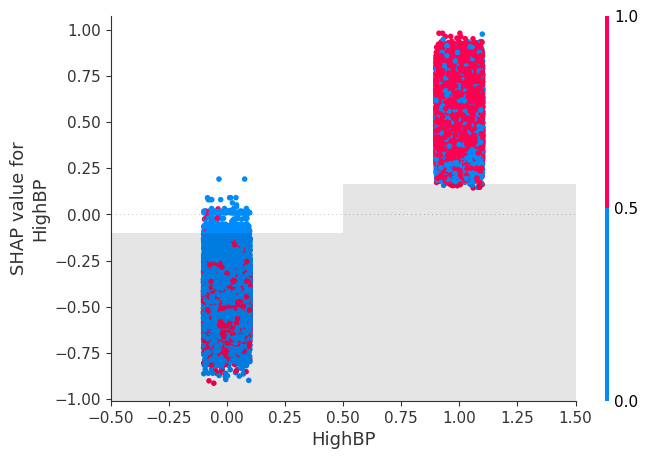

In [227]:
color = pipeline.predict(features)

for name in feature_importance_names[:5]:
    shap.plots.scatter(shap_values[:,name], 
                       color=color, # color por etiqueta predicha
                       xmin=0) # se agrega valor minimo = 0 para tener una mejor visualización

**¿Qué puede concluir de sus resultados?** 

Primero, en el gráfico de Age (la única variables no binaria de las presentadas) se observa que a medida que aumenta la edad, mayor es el aporte positivo en la predicció de parte de los datos, de donde se puede conlcuir que, en general, la edad tiene una relación positiva con la predcción de diabétes. Aún así, la relación no se cumple todas las veces. 

En cuanto a las variables binarias de Sex y PhysActivity, no se aprecia una relación entre el signo del Shap value con el valor de la variable. Para ambos valores (de cada variable) hay aportes positivos y negativos en la predicción. 

Por último, en las variables binarias de CholCheck y HighBP si se logra observar una relación positiva entre la variable y la predicción de diabetes. pues en los "bins" en donde las variables (CholCheck y HighBP) valen $1$ hya mayor presencia de datos con aporte positivo en la predicción, siendo en la segunda variable una relación positiva mucho más marcada que en la primera. 


    

### 5.5 Partial Dependence Plot (4 puntos)

Finalmente, se le pide generar un gráfico del tipo Partial Dependence Plot para las mismas 5 variables con mayor impacto global usando una submuestra de 1000 observaciones. ¿Qué relación existe entre la salida promedio del modelo y cada feature analizada? ¿Son estas conclusiones generalizables para todo el conjunto de datos?

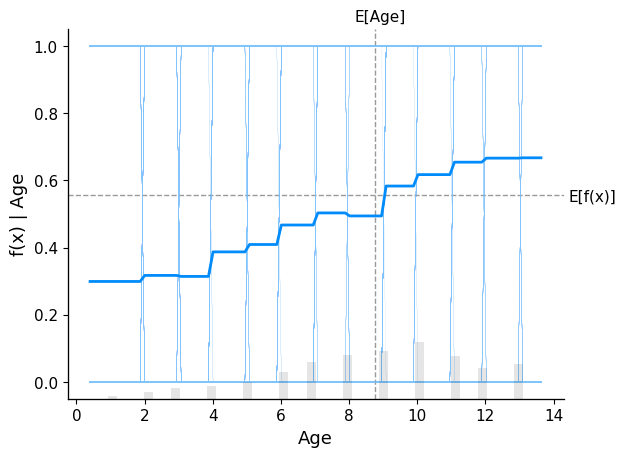

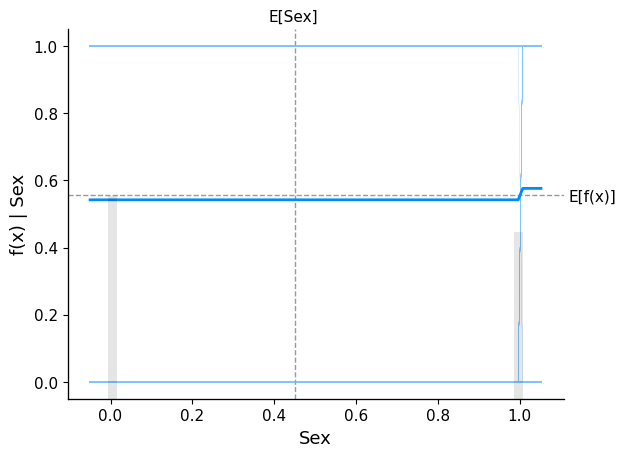

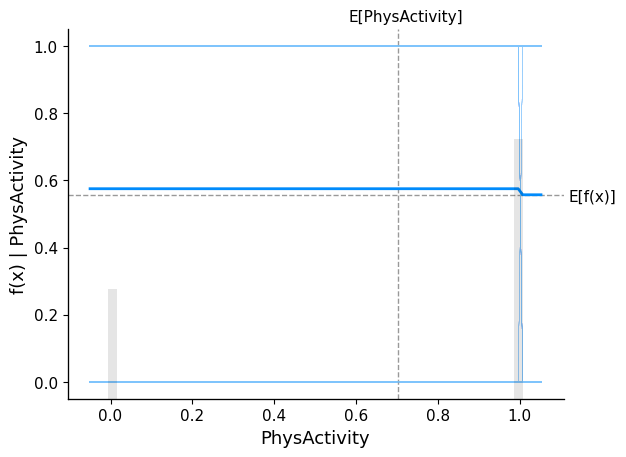

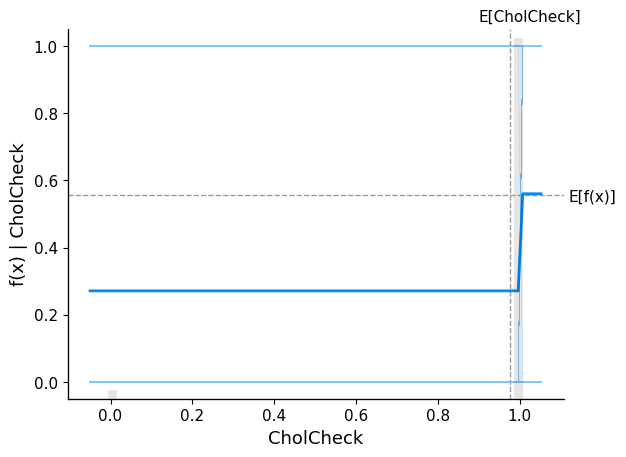

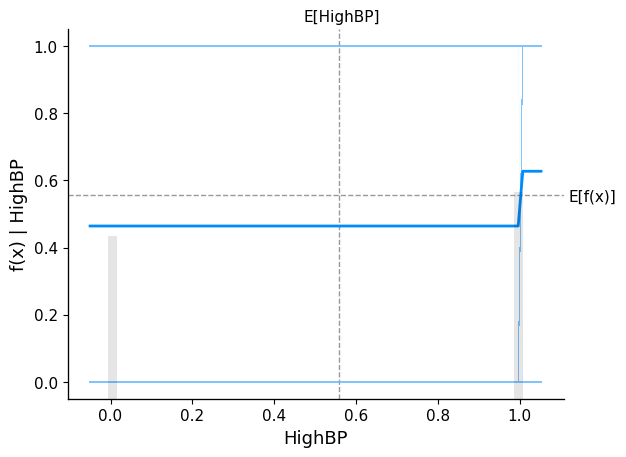

In [231]:
# Inserte código para generar gráficos PDP aquí
subsample1000 = shap.utils.sample(features, 1000)

for name in feature_importance_names[:5]:
    shap.partial_dependence_plot(
        name, pipeline.predict, subsample1000, model_expected_value=True,
        feature_expected_value=True, ice=True)

**¿Qué relación existe entre la salida promedio del modelo y cada feature analizada? ¿Son estas conclusiones generalizables para todo el conjunto de datos?** 

En cuanto a la relación entre la salida promedio del modelo y la variable Age, vemos que se marca una relación que es positiva y de forma escalonada (dada probablemente al tipo de variable de Age que es categórica), pues a medida qeu aumenta la característica Age también lo hace el valor promedio de salida. 

Sobre las otras cuatro features analizadas (Sex, PhysActivity, CholCheck y HighBP), todas variables binarias, se observa una grafica de salida promedio constante excepto por una discontinuidad. Esto indica la presencia de un umbral en dichas variables (todos en el 1, dada la bianriedad de estas) a partir del cual hay un cambio (ya sea aumento o disminución) en el valor de salida del modelo.  

Por último, respecto a la posibilidad de generalización de estas conclusiones, como ya vimos antes, no hay nada que asegure a ciencia cierta la correctitud al momento de generalizar un análisis local a uno global. Sin embargo, podemos inferir que esta depende fuertemente de la representatividad del conjunto utilizado y de la estabilidad del modelo.

## 6. Sistema de Reglas! (10 punto)

<p align="center">
  <img src="https://media.baamboozle.com/uploads/images/125978/1638281150_1380186_gif-url.gif" width="400">
</p>

Después de todo el trabajo hecho, Dr. Simi le pide simplificar el funcionamiento de su modelo en un sistema de reglas que le permita explicar a sus clientes las predicciones que genera su modelo. 
En particular, Dr. Simi le pide explicar la decisión tomada para las observaciones **1000**, **3001** y **5751**. Con las reglas propuestas señale a **cuánta población** es posible explicar con estas reglas e indique la **precisión** que poseen las reglas en la totalidad de los datos. ¿Tienen sentido sus reglas propuestas para las observaciones?. Fundamente sus respuesta señalando el impacto que tienen sus reglas sobre todo el conjunto de datos.

`Hint:` Como debe entregar las columnas que entran al clasificador entrenado de su pipeline, le será útil extraer el paso de preprocesamiento y generar dataframes preprocesados para el conjunto `train` y `test`. 

In [235]:
#!pip install alibi

In [237]:
from alibi.explainers import AnchorTabular

In [241]:
prep = pipeline.named_steps['prepro']
X_train, X_test, y_train, y_test = train_test_split(prep.fit_transform(features), labels, test_size=1/3, random_state=30)

In [243]:
# Inserte su código para generar sistema de reglas aquí
predict_fn = lambda x: xgb_model.predict(x) # creamos función de predicción
explainer = AnchorTabular(predict_fn, xgb_model.feature_names_in_, seed=1) # instanciamos Anchor usando función creada
explainer.fit(X_train.to_numpy()) # sobre los datos

# explicar predicción idx 1000
idx = 1000
print(f'id observación: {idx}')
obs = np.array(X_test.iloc[idx], ndmin = 2) # array de la obs

explanation = explainer.explain(obs, threshold=0.95) # generar anchor
print('Prediction: ', explainer.predictor(X_test.to_numpy()[idx].reshape(1, -1))[0]) # obtener prediccion del modelo 
print('Anchor: %s' % (' AND '.join(explanation.anchor))) # obtener regla 
print('Precision: %.2f' % explanation.precision) # obtener precision
print('Coverage: %.2f' % explanation.coverage) # obtener cobertura
print('-----------------------------------------------------------------------')

# explicar predicción idx 3001
idx = 3001
print(f'id observación: {idx}')
obs = np.array(X_test.iloc[idx], ndmin = 2) # array de la obs

explanation = explainer.explain(obs, threshold=0.95) # generar anchor
print('Prediction: ', explainer.predictor(X_test.to_numpy()[idx].reshape(1, -1))[0]) # obtener prediccion del modelo 
print('Anchor: %s' % (' AND '.join(explanation.anchor))) # obtener regla 
print('Precision: %.2f' % explanation.precision) # obtener precision
print('Coverage: %.2f' % explanation.coverage) # obtener cobertura
print('-----------------------------------------------------------------------')

# explicar predicción idx 5751
idx = 5751
print(f'id observación: {idx}')
obs = np.array(X_test.iloc[idx], ndmin = 2) # array de la obs

explanation = explainer.explain(obs, threshold=0.95) # generar anchor
print('Prediction: ', explainer.predictor(X_test.to_numpy()[idx].reshape(1, -1))[0]) # obtener prediccion del modelo 
print('Anchor: %s' % (' AND '.join(explanation.anchor))) # obtener regla 
print('Precision: %.2f' % explanation.precision) # obtener precision
print('Coverage: %.2f' % explanation.coverage) # obtener cobertura
print('-----------------------------------------------------------------------')


id observación: 1000
Prediction:  1
Anchor: GenHlth > 0.25 AND HighBP > 0.00 AND Age > 9.00
Precision: 0.95
Coverage: 0.21
-----------------------------------------------------------------------
id observación: 3001
Prediction:  0
Anchor: GenHlth <= 0.25 AND HighBP <= 0.00 AND BMI <= -0.12
Precision: 0.98
Coverage: 0.19
-----------------------------------------------------------------------
id observación: 5751
Prediction:  1
Anchor: GenHlth > 0.75 AND HighBP > 0.00
Precision: 0.96
Coverage: 0.06
-----------------------------------------------------------------------


**¿Tienen sentido sus reglas propuestas para las observaciones?. Fundamente sus respuesta señalando el impacto que tienen sus reglas sobre todo el conjunto de datos.**

Las reglas propuestas presentan relaciones entre variables, las cuales tienen sentido desde el dominio del problema. Por ejemplo, la primera regla indica:
- GenHlth > 0.25: Mayor GenHlth indica mala salud general
- HighBP > 0.00: Mayor HighBP indica mayor presión arteríal 
- Age > 9.00: Que indica más de 9 años. 
Cuyas observaciones hacen sentido diagnosticar como "diabetes", que es lo que se hizo al indicar "Prediction:  1". 

Por otro lado, las tres reglas propuestas presentan una alta precisión (0.95, 0.98 y 0.96), todas cercanas a al máximo, lo que indica que tienen una alta confianza para predecir la clase de las observaciones que cumplen la regla.
Sin embargo, la cobertura de las reglas es variable, teniendo dos reglas con cobrtura aproximada de 0.2 (0.21 y 0.19) y una con conbertura mucho más baja de 0.06. Esto significa que dichas dos reglas explican una mayor proporción de las observaciones que la tercera, la cual es muy poco general. 

En general, las tres reglas presentan una cobertura pequeña, solo el 20% de los datos, por lo que si bien tienen sentido en el dominio y buena precisión, no podemos afirmar que dichas reglas hacen sentido globalmente para predecir la etiqueta. 

# Retrospectiva... (10 puntos)

En base a los diferentes métodos que implementa y ha comentado en este laboratorio, comente qué métodos le permiten entregar mejores conclusiones para la tarea de clasificación de diabetes. Por otro lado, ¿qué métodos son más útiles para el problema del doctor Simi, métodos agnosticos locales o globales?

**Respuesta:** \

El método que mejor permite entegar conclusiones de interpretabilidad sobre la tarea de clasificación de diabetes es el método Shap, pues permite visualizar la importancia global y local de las características, siendo ambas importantes a la hora de trabajar con diagnóticos de enfermedades. 

Por un lado, para cuando se quiere dar interpretabilidad a la tarea de clasificación en el sentido global, y obtener las varibales más importan para definir la etiqueta de diabetes, el método de permutación si bien presenta buenos resultados tiene la desventaja de depender del error intrínseco del modelo, por lo que en conclusión, se prefiere la utilización del método Shap para reaizar esta tarea, que a su vez, tienen la buen nivel de interpretabilidad.  

Por otro lado, cuando se quiere obtener una interpretabilidad sobre redicciones particulares, como por ejemplo predicciones de presencia de diabetes en un usuario específico, el método shap también permite ver qué varibles son las más importantes para la predicción caso a caso, permitiendo un análisis local y aterrizado. 

Por último mensionar que si bien el sistema de reglas tienen la ventaja de tener muy buena interpretabilidad y explicabilidad al resolver directamente preguntas de "porqué se hiza tal predicción?", la factibilidad del método esta sujeta a la calidad de los datos, y también a que las reglas obtenidas tengan un sentido esde le punto de vista del domino del problema, lo que no se puede asegurar siempre que se utilice el método. 

En conclusión, los método agnósticos globales y locales se utilizan con distintos objetivos y ambos son importantes en la tarea dl doctor Simi y dada la flexibilidad en este aspecto del método Shap es que se escoge como el más indicado. 


# Conclusión
Eso ha sido todo para el lab de hoy, recuerden que el laboratorio tiene un plazo de entrega de una semana. Cualquier duda del laboratorio, no duden en contactarnos por mail o U-cursos.

![Gracias Totales!](https://media.tenor.com/ctnq4bhZE3gAAAAC/drsimi-simi.gif)

<a style='text-decoration:none;line-height:16px;display:flex;color:#5B5B62;padding:10px;justify-content:end;' href='https://deepnote.com?utm_source=created-in-deepnote-cell&projectId=87110296-876e-426f-b91d-aaf681223468' target="_blank">
 </img>
Created in <span style='font-weight:600;margin-left:4px;'>Deepnote</span></a>